In [ ]:
%pip install ultralytics

In [ ]:
import ultralytics
ultralytics.checks()

# Prediction on single image

In [ ]:
# more configuration
import torch
conf = 0.3
device = 'mps' if torch.backends.mps.is_available() else 'cpu'

In [ ]:
model_path = '../models/pretrained/yolo11m.pt'
image_path = '/Users/phatvu/Library/CloudStorage/GoogleDrive-phatvu.coder@gmail.com/My Drive/Dev-Drive/Competitions/Competitions-2024/M10-BKAI-Object_Detection/BKAI_Hackathon_2024-Track1/data/raw/public test/cam_08_00500_jpg.rf.5ab59b5bcda1d1fad9131385c5d64fdb.jpg'

# Load model
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
model = YOLO(model_path)

# Load image and run detection
image = cv2.imread(image_path)
results = model(image, conf=conf, device=device)

# Plot results
annotated_image = results[0].plot()
annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
plt.imshow(annotated_image)
plt.axis('off')  # Hide axis
plt.show()

# Prediction on folder

In [ ]:
# more configuration
import torch
conf = 0.3
device = 'mps' if torch.backends.mps.is_available() else 'cpu'

## Using 1 model

In [ ]:
folder_path = "../data/raw/private test"
model_path = '../models/base2/base_m/base_m.pt'

from ultralytics import YOLO
import cv2
import glob
import os
import matplotlib.pyplot as plt

list_img = glob.glob(os.path.join(folder_path, "*.jpg"))

for img_path in list_img:
    # Load YOLO model and image
    model = YOLO(model_path)
    image = cv2.imread(img_path)

    # Run inference and show results
    results = model(image, conf=conf, device=device)
    
    # Plot results
    annotated_image = results[0].plot()
    annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    plt.imshow(annotated_image)
    plt.axis('off')  # Hide axis
    plt.show()

## Using 2 models

In [ ]:
folder_path = "../data/raw/private test"
model_day_path = '../models/base2/day/day.pt'
model_night_path = '../models/base2/night/night.pt'

import cv2
import numpy as np

class DayNightClassifier:
    def __init__(self,
                 night_intensity_ratio_threshold: float = 0.55,
                 brightness_threshold: int = 95):

        self.brightness_threshold = brightness_threshold
        self.night_intensity_ratio_threshold = night_intensity_ratio_threshold

    @staticmethod
    def enhance_contrast(image):
        clahe = cv2.createCLAHE(clipLimit=2.15, tileGridSize=(8, 8))
        enhanced_image = clahe.apply(image)
        return enhanced_image

    def calculate_histogram_and_brightness(self, image_path):
        # Đọc hình ảnh và chuyển sang grayscale
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        if image is None:
            return None, None

        # Tăng cường độ tương phản
        image = self.enhance_contrast(image)

        # Tính toán histogram
        hist = cv2.calcHist([image], [0], None, [256], [0, 256])
        hist = hist / hist.sum()

        # Tính độ sáng trung bình
        avg_brightness = np.mean(image)

        # Tính tỷ lệ pixel tối
        dark_pixel_ratio = hist[:self.brightness_threshold].sum()

        return dark_pixel_ratio, avg_brightness

    def isDay(self, image_path):
        dark_pixel_ratio, avg_brightness = self.calculate_histogram_and_brightness(image_path)

        if dark_pixel_ratio is None or avg_brightness is None:
            return None

        # Phân loại dựa trên tỷ lệ pixel tối
        if dark_pixel_ratio > self.night_intensity_ratio_threshold:
            return False  # Đêm

        # Phân loại dựa trên độ sáng trung bình
        return avg_brightness > self.brightness_threshold  # Ngày nếu độ sáng cao hơn ngưỡng

# Sử dụng method isDay để kiểm tra
classifier = DayNightClassifier(night_intensity_ratio_threshold=0.54, brightness_threshold=93)

from ultralytics import YOLO
import cv2
import glob
import os
import matplotlib.pyplot as plt

list_img = glob.glob(os.path.join(folder_path, "*.jpg"))

for img_path in list_img:
    # Kiểm tra ban đêm hay ban ngày
    is_day = classifier.isDay(img_path)
    print(f"Day: {is_day}")
    model_path = model_day_path if is_day else model_night_path

    # Load YOLO model and image
    model = YOLO(model_path)
    image = cv2.imread(img_path)

    # Run inference and show results
    results = model(image, device=device)
    
    # Plot results
    annotated_image = results[0].plot()
    annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    plt.imshow(annotated_image)
    plt.axis('off')  # Hide axis
    plt.show()

# Predict with area threshold

In [ ]:
# more configuration
import torch
conf = 0.45
device = 'mps' if torch.backends.mps.is_available() else 'cpu'


0: 384x640 2 motorbikes, 1 truck, 854.7ms
Speed: 11.0ms preprocess, 854.7ms inference, 27.0ms postprocess per image at shape (1, 3, 384, 640)


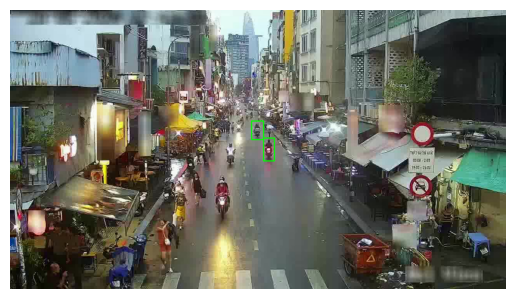


0: 384x640 1 motorbike, 1 truck, 63.8ms
Speed: 1.8ms preprocess, 63.8ms inference, 9.0ms postprocess per image at shape (1, 3, 384, 640)


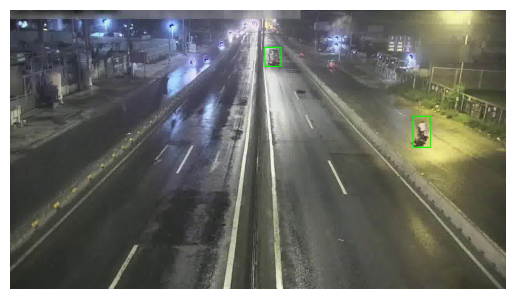


0: 384x640 (no detections), 68.1ms
Speed: 5.4ms preprocess, 68.1ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)


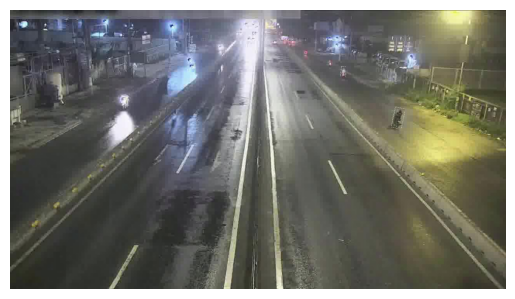


0: 384x640 3 motorbikes, 138.4ms
Speed: 2.0ms preprocess, 138.4ms inference, 6.4ms postprocess per image at shape (1, 3, 384, 640)


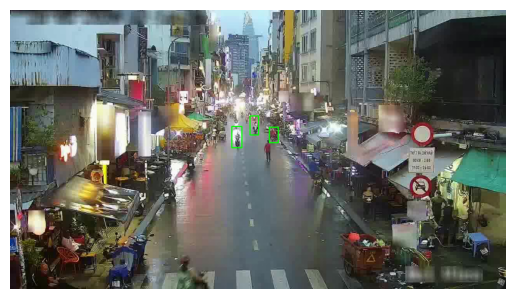


0: 384x640 9 motorbikes, 1 truck, 49.6ms
Speed: 2.0ms preprocess, 49.6ms inference, 13.6ms postprocess per image at shape (1, 3, 384, 640)


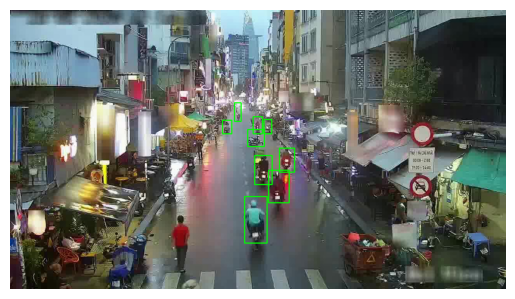


0: 384x640 (no detections), 97.4ms
Speed: 3.3ms preprocess, 97.4ms inference, 1.3ms postprocess per image at shape (1, 3, 384, 640)


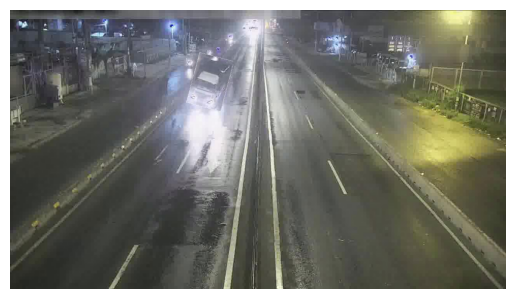


0: 384x640 2 motorbikes, 112.5ms
Speed: 3.5ms preprocess, 112.5ms inference, 10.4ms postprocess per image at shape (1, 3, 384, 640)


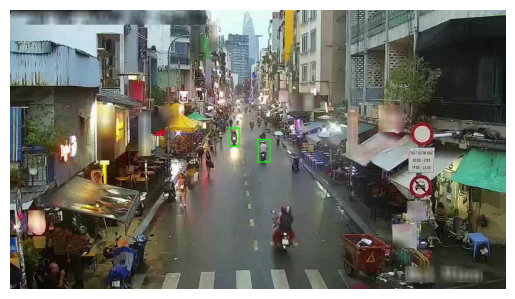


0: 384x640 (no detections), 51.6ms
Speed: 2.3ms preprocess, 51.6ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)


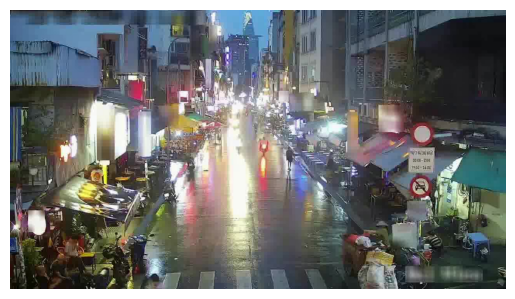


0: 384x640 1 motorbike, 1 truck, 52.8ms
Speed: 3.3ms preprocess, 52.8ms inference, 10.5ms postprocess per image at shape (1, 3, 384, 640)


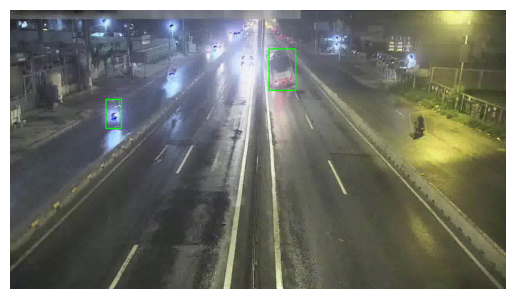


0: 384x640 1 motorbike, 127.3ms
Speed: 1.9ms preprocess, 127.3ms inference, 14.8ms postprocess per image at shape (1, 3, 384, 640)


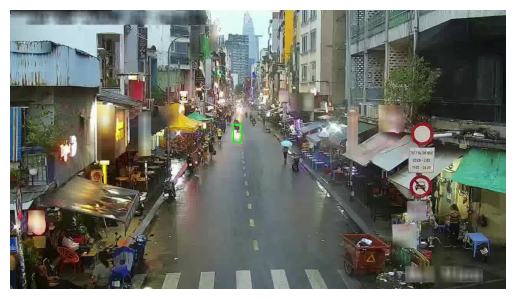


0: 384x640 (no detections), 61.3ms
Speed: 2.2ms preprocess, 61.3ms inference, 5.7ms postprocess per image at shape (1, 3, 384, 640)


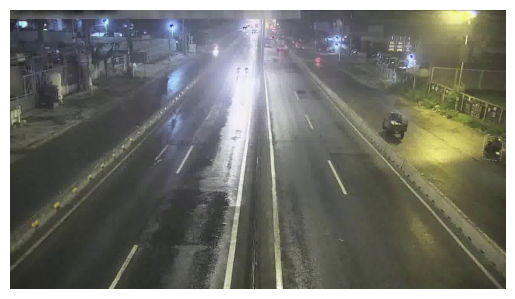


0: 384x640 (no detections), 57.9ms
Speed: 2.4ms preprocess, 57.9ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)


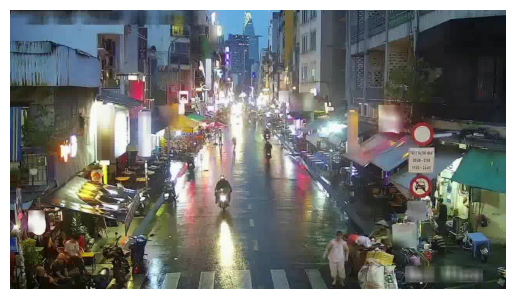


0: 384x640 2 motorbikes, 100.0ms
Speed: 1.6ms preprocess, 100.0ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)


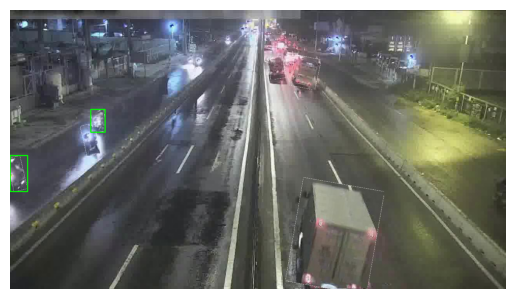


0: 384x640 (no detections), 51.6ms
Speed: 2.4ms preprocess, 51.6ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)


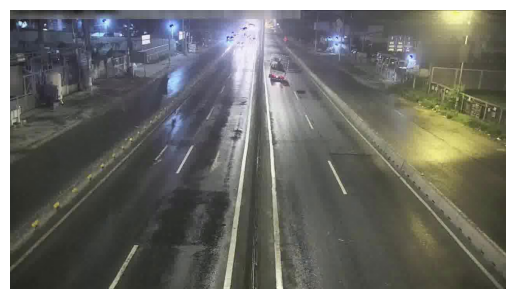


0: 384x640 1 motorbike, 51.0ms
Speed: 2.2ms preprocess, 51.0ms inference, 10.8ms postprocess per image at shape (1, 3, 384, 640)


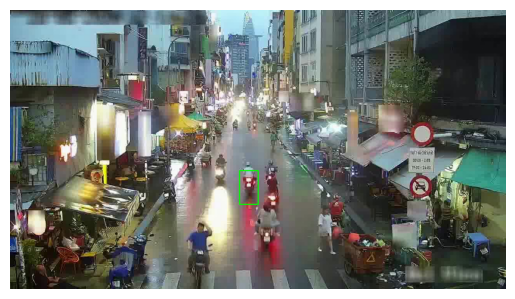


0: 384x640 1 motorbike, 86.8ms
Speed: 2.2ms preprocess, 86.8ms inference, 5.2ms postprocess per image at shape (1, 3, 384, 640)


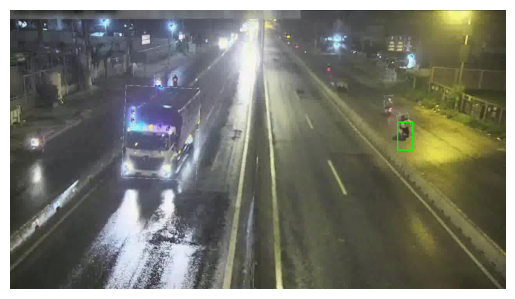


0: 384x640 (no detections), 59.4ms
Speed: 2.1ms preprocess, 59.4ms inference, 3.3ms postprocess per image at shape (1, 3, 384, 640)


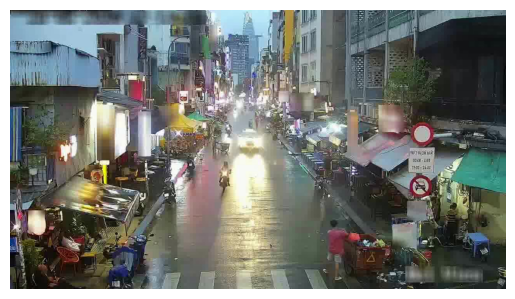


0: 384x640 1 truck, 246.2ms
Speed: 2.8ms preprocess, 246.2ms inference, 8.9ms postprocess per image at shape (1, 3, 384, 640)


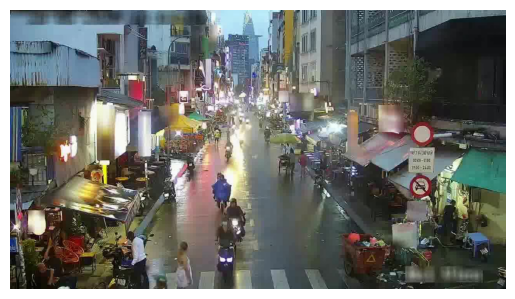


0: 384x640 2 motorbikes, 1 car, 50.0ms
Speed: 2.2ms preprocess, 50.0ms inference, 9.9ms postprocess per image at shape (1, 3, 384, 640)


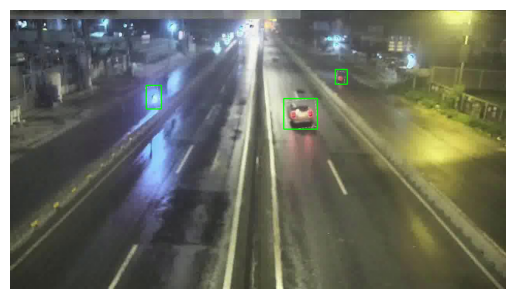


0: 384x640 1 motorbike, 89.6ms
Speed: 1.7ms preprocess, 89.6ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)


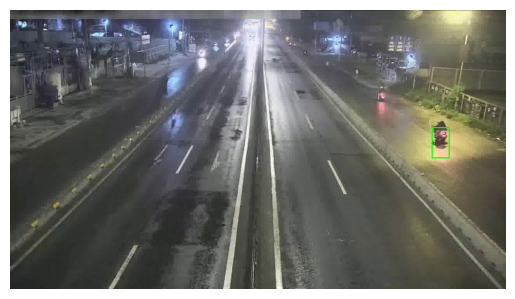


0: 384x640 2 motorbikes, 50.7ms
Speed: 2.0ms preprocess, 50.7ms inference, 11.5ms postprocess per image at shape (1, 3, 384, 640)


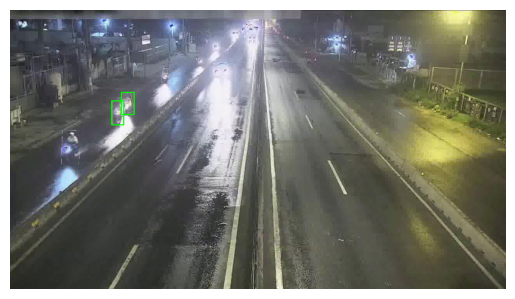


0: 384x640 1 motorbike, 121.8ms
Speed: 2.0ms preprocess, 121.8ms inference, 11.7ms postprocess per image at shape (1, 3, 384, 640)


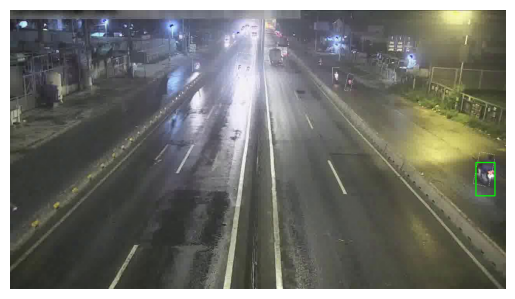


0: 384x640 5 motorbikes, 47.9ms
Speed: 1.8ms preprocess, 47.9ms inference, 11.8ms postprocess per image at shape (1, 3, 384, 640)


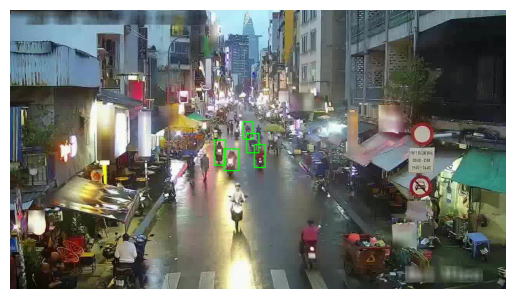


0: 384x640 (no detections), 91.8ms
Speed: 3.5ms preprocess, 91.8ms inference, 6.7ms postprocess per image at shape (1, 3, 384, 640)


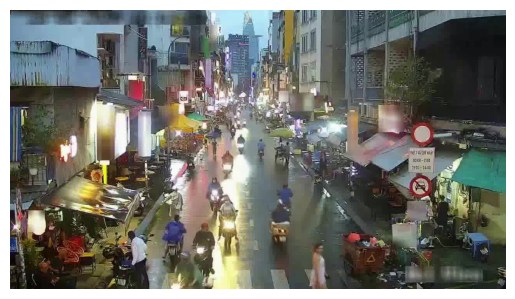


0: 384x640 (no detections), 55.9ms
Speed: 1.8ms preprocess, 55.9ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)


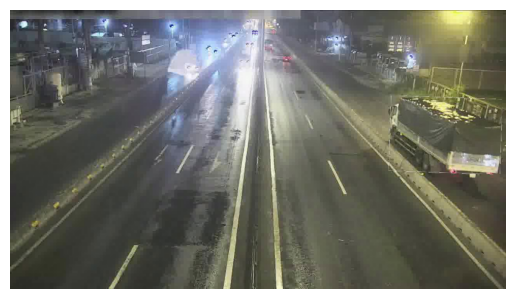


0: 384x640 2 motorbikes, 1 car, 89.2ms
Speed: 2.0ms preprocess, 89.2ms inference, 10.7ms postprocess per image at shape (1, 3, 384, 640)


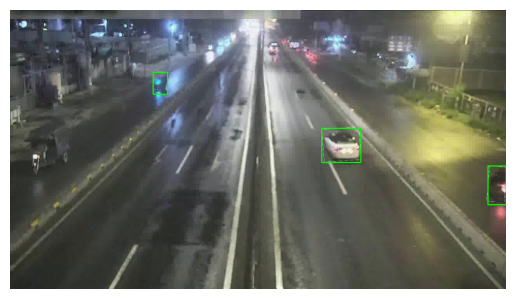


0: 384x640 2 motorbikes, 52.0ms
Speed: 2.2ms preprocess, 52.0ms inference, 13.1ms postprocess per image at shape (1, 3, 384, 640)


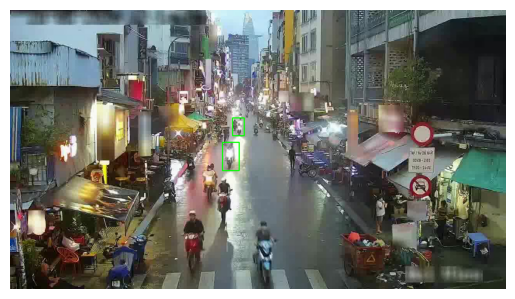


0: 384x640 1 motorbike, 130.4ms
Speed: 20.5ms preprocess, 130.4ms inference, 7.1ms postprocess per image at shape (1, 3, 384, 640)


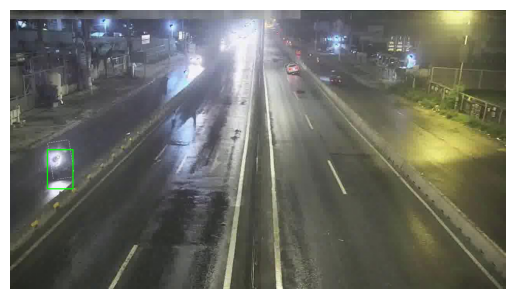


0: 384x640 1 motorbike, 1 car, 1 truck, 58.0ms
Speed: 2.2ms preprocess, 58.0ms inference, 10.2ms postprocess per image at shape (1, 3, 384, 640)


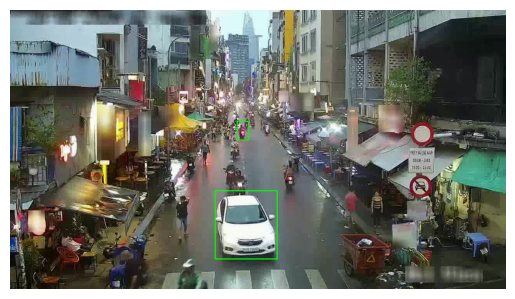


0: 384x640 1 motorbike, 1 truck, 107.9ms
Speed: 2.1ms preprocess, 107.9ms inference, 10.3ms postprocess per image at shape (1, 3, 384, 640)


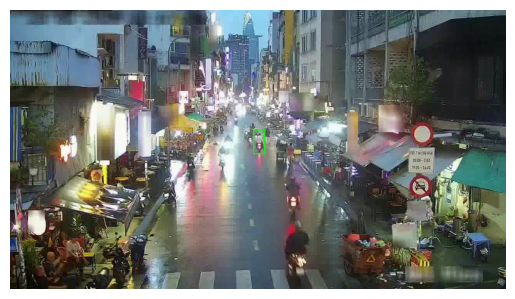


0: 384x640 (no detections), 49.2ms
Speed: 1.6ms preprocess, 49.2ms inference, 6.6ms postprocess per image at shape (1, 3, 384, 640)


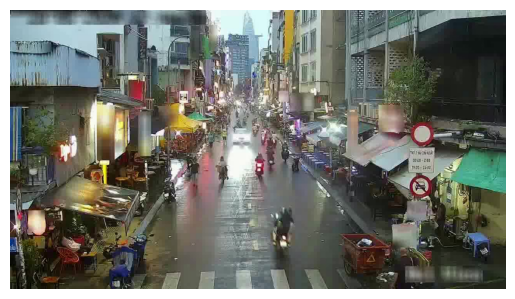


0: 384x640 1 motorbike, 111.6ms
Speed: 2.2ms preprocess, 111.6ms inference, 5.0ms postprocess per image at shape (1, 3, 384, 640)


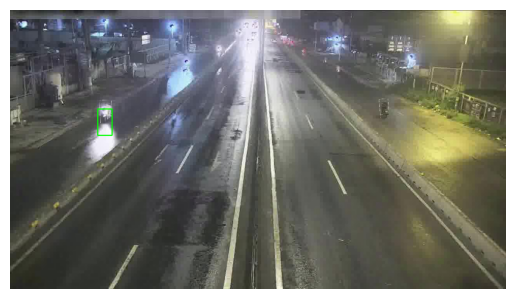


0: 384x640 (no detections), 54.0ms
Speed: 2.2ms preprocess, 54.0ms inference, 5.0ms postprocess per image at shape (1, 3, 384, 640)


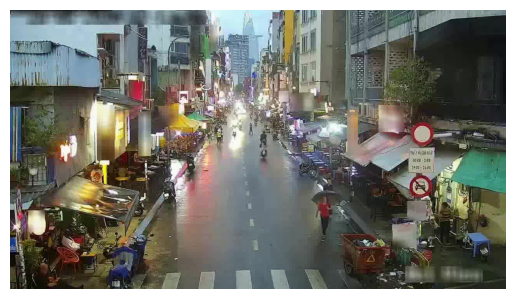


0: 384x640 2 motorbikes, 109.3ms
Speed: 2.7ms preprocess, 109.3ms inference, 9.5ms postprocess per image at shape (1, 3, 384, 640)


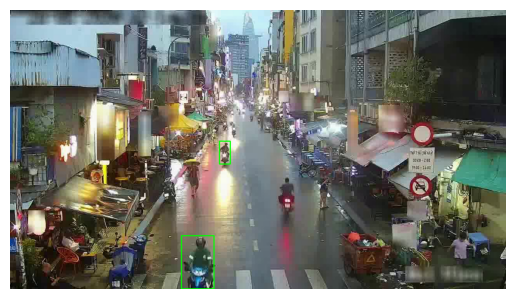


0: 384x640 (no detections), 67.8ms
Speed: 2.5ms preprocess, 67.8ms inference, 4.8ms postprocess per image at shape (1, 3, 384, 640)


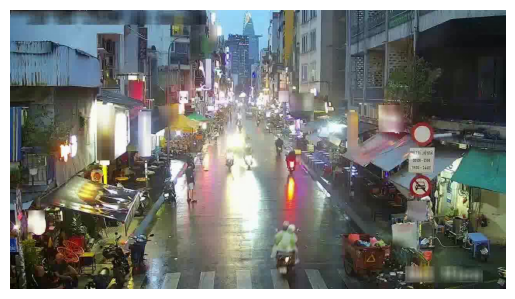


0: 384x640 1 motorbike, 1 car, 2 trucks, 110.4ms
Speed: 2.5ms preprocess, 110.4ms inference, 15.5ms postprocess per image at shape (1, 3, 384, 640)


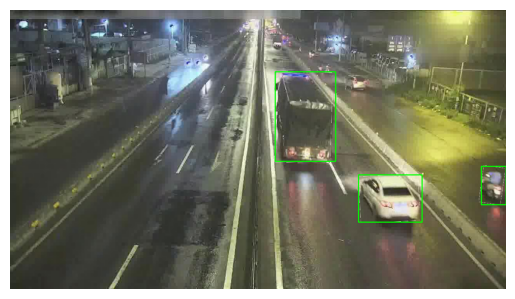


0: 384x640 1 car, 57.1ms
Speed: 2.3ms preprocess, 57.1ms inference, 7.2ms postprocess per image at shape (1, 3, 384, 640)


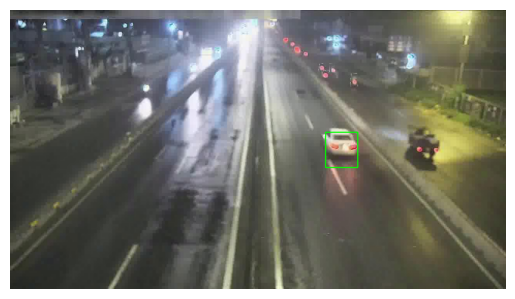


0: 384x640 (no detections), 117.9ms
Speed: 2.4ms preprocess, 117.9ms inference, 8.6ms postprocess per image at shape (1, 3, 384, 640)


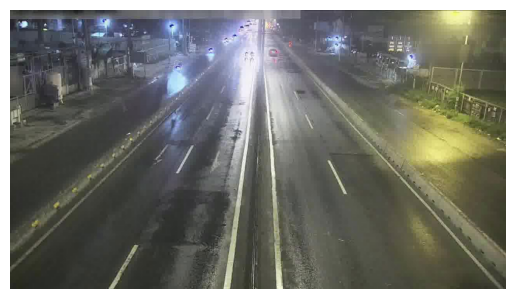


0: 384x640 2 motorbikes, 50.3ms
Speed: 2.5ms preprocess, 50.3ms inference, 10.6ms postprocess per image at shape (1, 3, 384, 640)


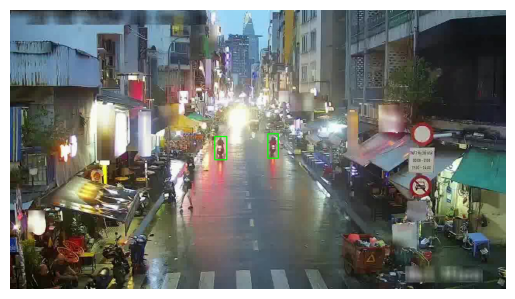


0: 384x640 (no detections), 98.0ms
Speed: 2.5ms preprocess, 98.0ms inference, 7.6ms postprocess per image at shape (1, 3, 384, 640)


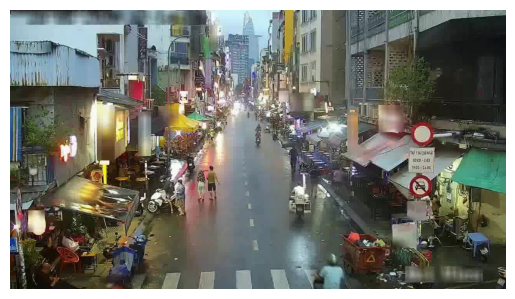


0: 384x640 1 motorbike, 131.5ms
Speed: 2.9ms preprocess, 131.5ms inference, 15.8ms postprocess per image at shape (1, 3, 384, 640)


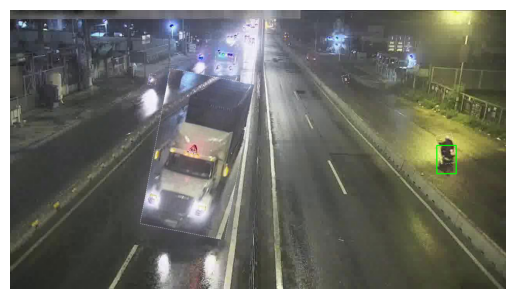


0: 384x640 2 motorbikes, 50.7ms
Speed: 1.9ms preprocess, 50.7ms inference, 8.8ms postprocess per image at shape (1, 3, 384, 640)


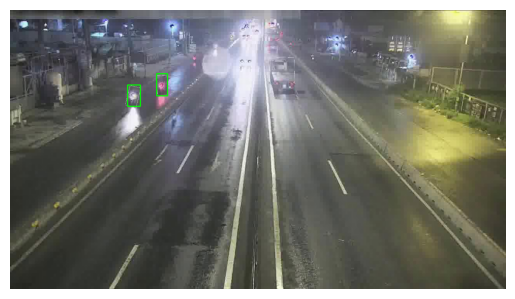


0: 384x640 (no detections), 67.6ms
Speed: 2.3ms preprocess, 67.6ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


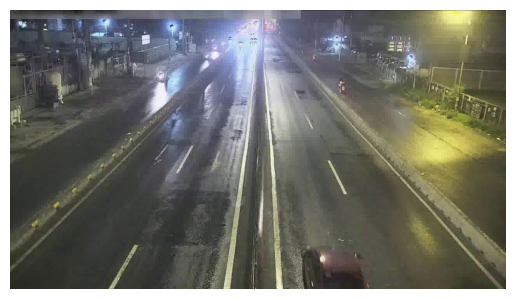


0: 384x640 (no detections), 95.9ms
Speed: 2.9ms preprocess, 95.9ms inference, 4.2ms postprocess per image at shape (1, 3, 384, 640)


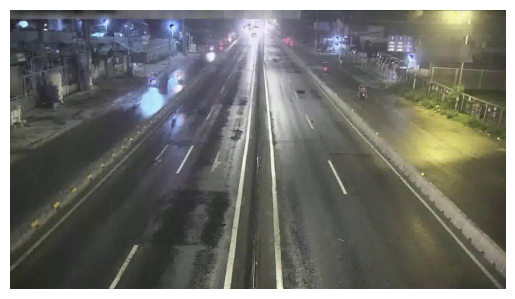


0: 384x640 1 motorbike, 95.7ms
Speed: 2.6ms preprocess, 95.7ms inference, 10.6ms postprocess per image at shape (1, 3, 384, 640)


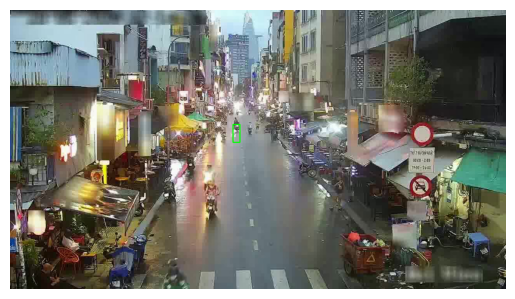


0: 384x640 1 motorbike, 2 trucks, 134.2ms
Speed: 1.5ms preprocess, 134.2ms inference, 9.8ms postprocess per image at shape (1, 3, 384, 640)


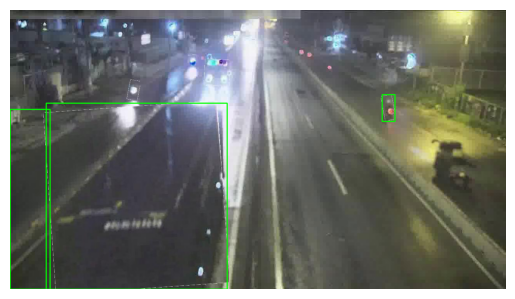


0: 384x640 (no detections), 104.6ms
Speed: 1.9ms preprocess, 104.6ms inference, 5.1ms postprocess per image at shape (1, 3, 384, 640)


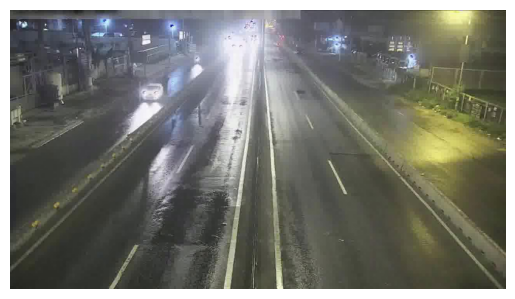


0: 384x640 (no detections), 98.4ms
Speed: 1.7ms preprocess, 98.4ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


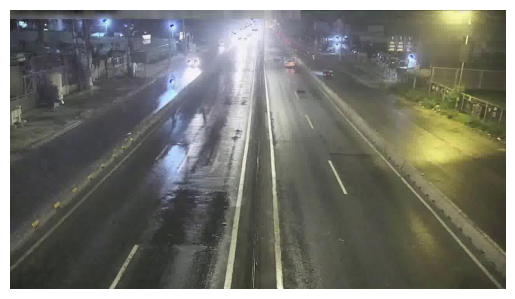


0: 384x640 (no detections), 96.9ms
Speed: 2.1ms preprocess, 96.9ms inference, 1.1ms postprocess per image at shape (1, 3, 384, 640)


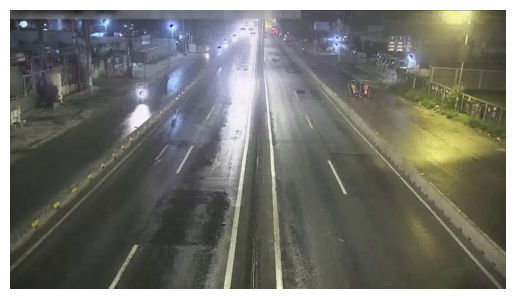


0: 384x640 1 motorbike, 97.6ms
Speed: 2.0ms preprocess, 97.6ms inference, 12.6ms postprocess per image at shape (1, 3, 384, 640)


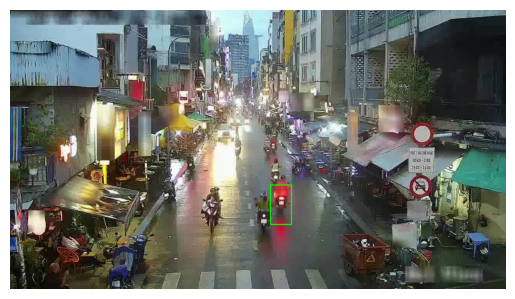


0: 384x640 (no detections), 98.8ms
Speed: 2.4ms preprocess, 98.8ms inference, 1.9ms postprocess per image at shape (1, 3, 384, 640)


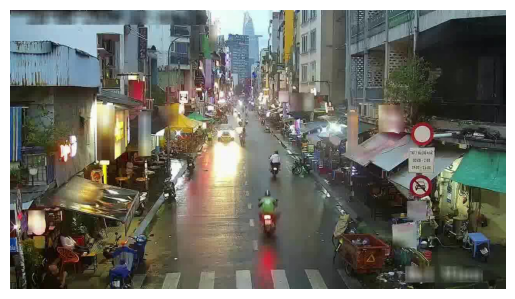


0: 384x640 1 motorbike, 134.2ms
Speed: 2.0ms preprocess, 134.2ms inference, 8.2ms postprocess per image at shape (1, 3, 384, 640)


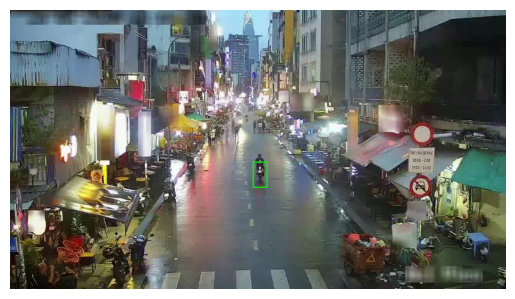


0: 384x640 1 motorbike, 96.4ms
Speed: 2.8ms preprocess, 96.4ms inference, 10.5ms postprocess per image at shape (1, 3, 384, 640)


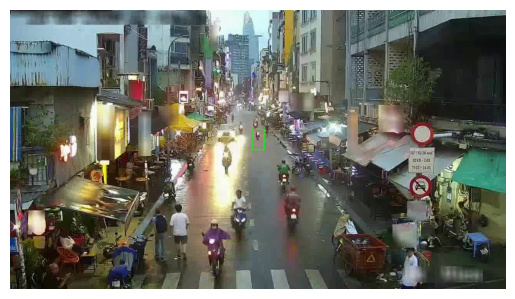


0: 384x640 3 motorbikes, 1 car, 107.6ms
Speed: 1.8ms preprocess, 107.6ms inference, 11.1ms postprocess per image at shape (1, 3, 384, 640)


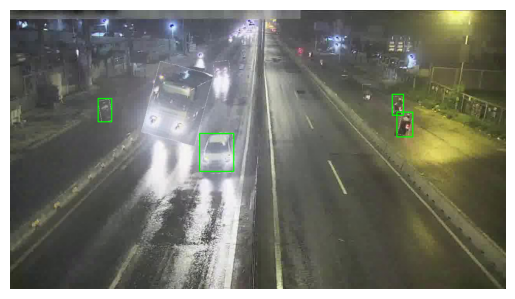


0: 384x640 4 motorbikes, 112.9ms
Speed: 2.4ms preprocess, 112.9ms inference, 5.8ms postprocess per image at shape (1, 3, 384, 640)


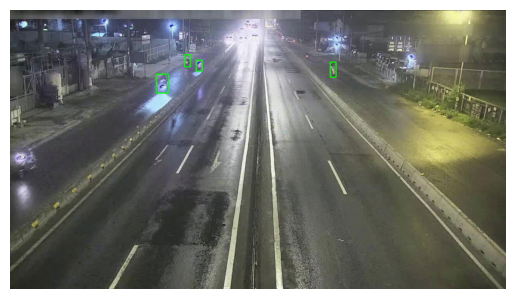


0: 384x640 2 motorbikes, 96.6ms
Speed: 2.2ms preprocess, 96.6ms inference, 11.6ms postprocess per image at shape (1, 3, 384, 640)


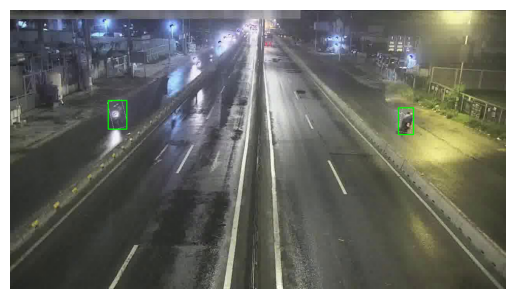


0: 384x640 (no detections), 95.3ms
Speed: 2.0ms preprocess, 95.3ms inference, 3.6ms postprocess per image at shape (1, 3, 384, 640)


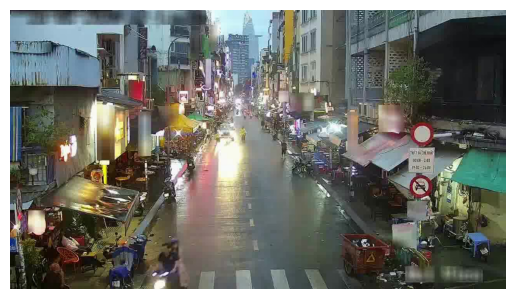


0: 384x640 1 motorbike, 2 cars, 1 truck, 102.1ms
Speed: 2.4ms preprocess, 102.1ms inference, 11.8ms postprocess per image at shape (1, 3, 384, 640)


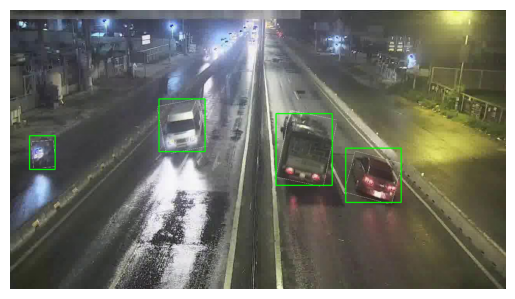


0: 384x640 3 motorbikes, 1 car, 106.7ms
Speed: 2.0ms preprocess, 106.7ms inference, 12.2ms postprocess per image at shape (1, 3, 384, 640)


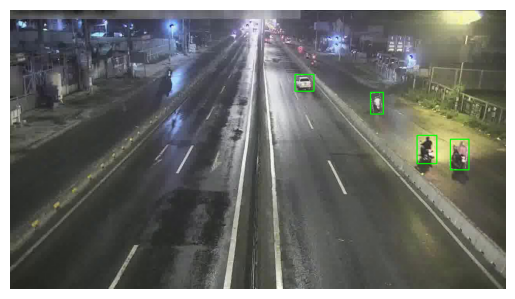


0: 384x640 2 motorbikes, 124.2ms
Speed: 1.5ms preprocess, 124.2ms inference, 7.3ms postprocess per image at shape (1, 3, 384, 640)


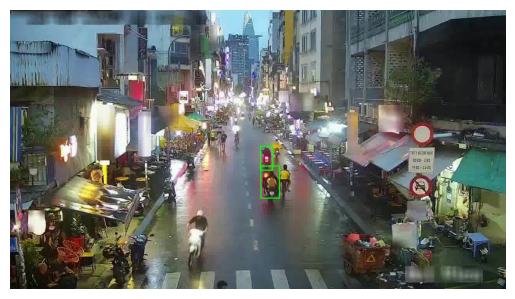


0: 384x640 1 motorbike, 1 car, 127.4ms
Speed: 2.5ms preprocess, 127.4ms inference, 9.3ms postprocess per image at shape (1, 3, 384, 640)


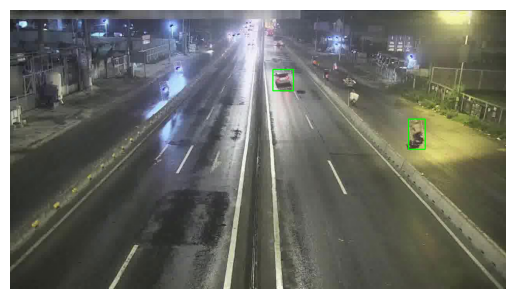


0: 384x640 3 motorbikes, 249.1ms
Speed: 2.2ms preprocess, 249.1ms inference, 15.8ms postprocess per image at shape (1, 3, 384, 640)


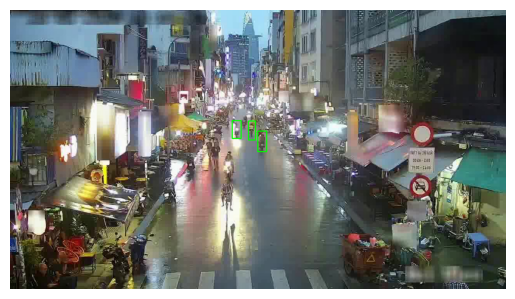


0: 384x640 6 motorbikes, 120.8ms
Speed: 1.6ms preprocess, 120.8ms inference, 11.6ms postprocess per image at shape (1, 3, 384, 640)


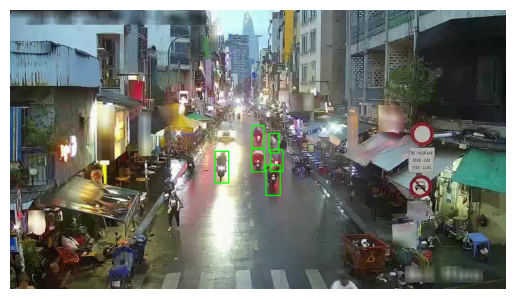


0: 384x640 1 car, 115.5ms
Speed: 1.9ms preprocess, 115.5ms inference, 7.3ms postprocess per image at shape (1, 3, 384, 640)


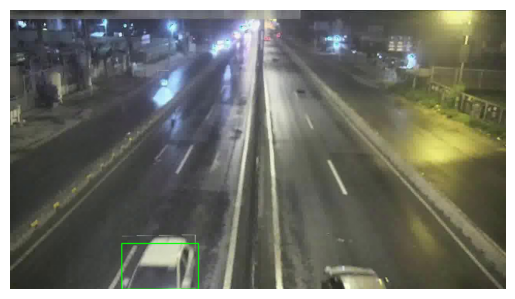


0: 384x640 1 motorbike, 1 car, 129.7ms
Speed: 23.2ms preprocess, 129.7ms inference, 9.7ms postprocess per image at shape (1, 3, 384, 640)


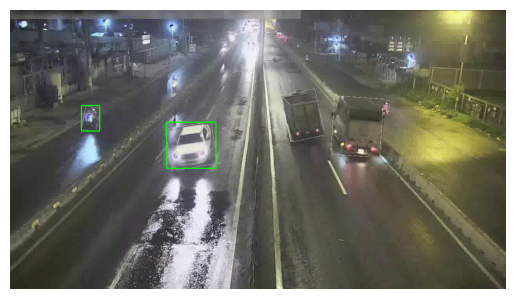


0: 384x640 2 motorbikes, 1 truck, 114.7ms
Speed: 2.0ms preprocess, 114.7ms inference, 10.8ms postprocess per image at shape (1, 3, 384, 640)


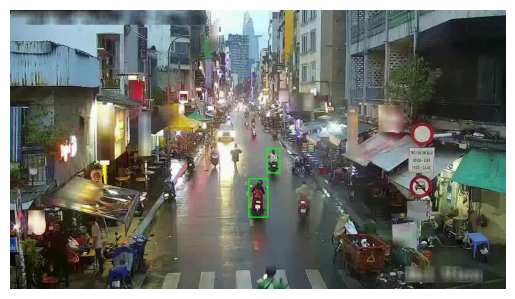


0: 384x640 1 car, 1 truck, 115.0ms
Speed: 1.9ms preprocess, 115.0ms inference, 6.3ms postprocess per image at shape (1, 3, 384, 640)


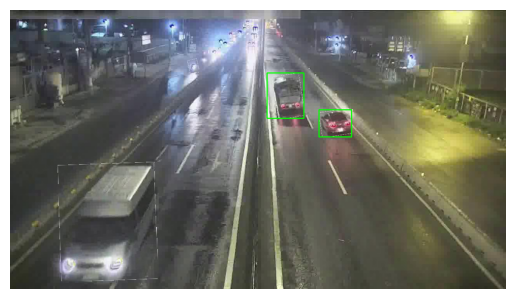


0: 384x640 1 truck, 142.7ms
Speed: 1.8ms preprocess, 142.7ms inference, 13.6ms postprocess per image at shape (1, 3, 384, 640)


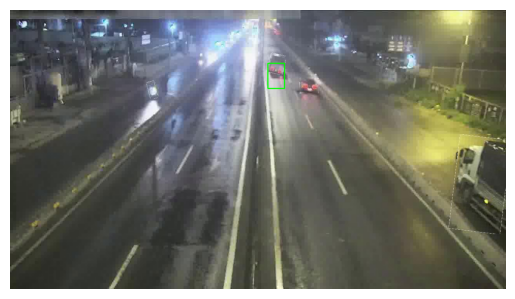


0: 384x640 1 motorbike, 105.1ms
Speed: 2.1ms preprocess, 105.1ms inference, 5.1ms postprocess per image at shape (1, 3, 384, 640)


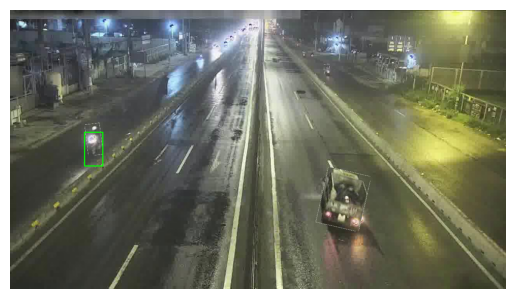


0: 384x640 2 motorbikes, 1 car, 164.1ms
Speed: 2.4ms preprocess, 164.1ms inference, 12.1ms postprocess per image at shape (1, 3, 384, 640)


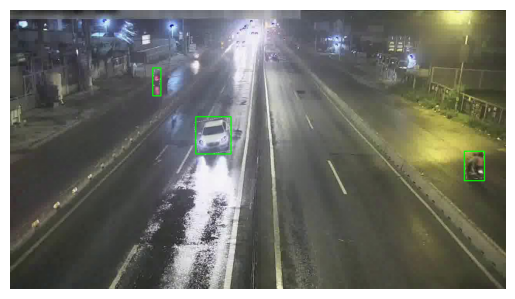


0: 384x640 (no detections), 142.4ms
Speed: 2.0ms preprocess, 142.4ms inference, 11.2ms postprocess per image at shape (1, 3, 384, 640)


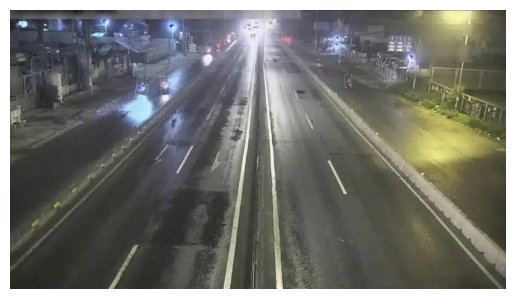


0: 384x640 3 motorbikes, 102.9ms
Speed: 2.0ms preprocess, 102.9ms inference, 8.5ms postprocess per image at shape (1, 3, 384, 640)


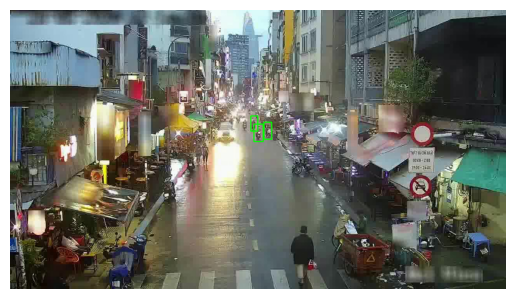


0: 384x640 (no detections), 138.5ms
Speed: 6.2ms preprocess, 138.5ms inference, 2.2ms postprocess per image at shape (1, 3, 384, 640)


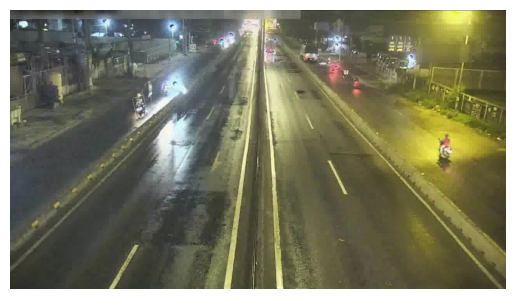


0: 384x640 2 motorbikes, 1 car, 115.3ms
Speed: 2.4ms preprocess, 115.3ms inference, 9.4ms postprocess per image at shape (1, 3, 384, 640)


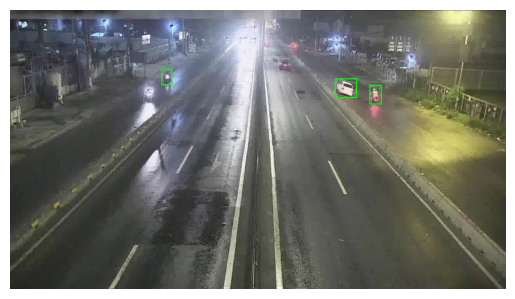


0: 384x640 4 motorbikes, 101.8ms
Speed: 2.0ms preprocess, 101.8ms inference, 13.7ms postprocess per image at shape (1, 3, 384, 640)


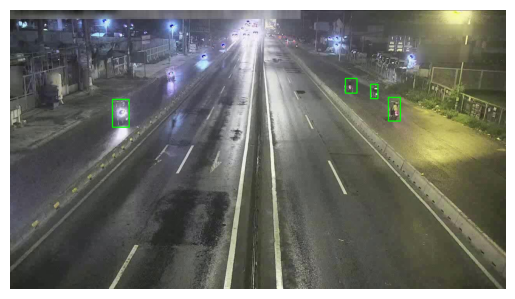


0: 384x640 1 car, 133.3ms
Speed: 2.4ms preprocess, 133.3ms inference, 11.1ms postprocess per image at shape (1, 3, 384, 640)


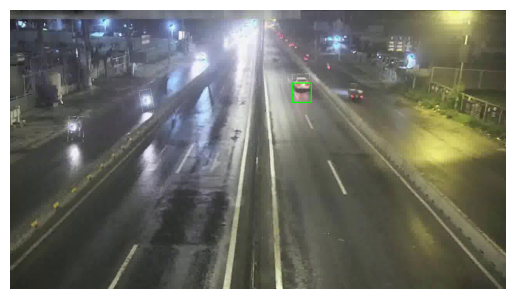


0: 384x640 1 motorbike, 102.9ms
Speed: 2.0ms preprocess, 102.9ms inference, 5.9ms postprocess per image at shape (1, 3, 384, 640)


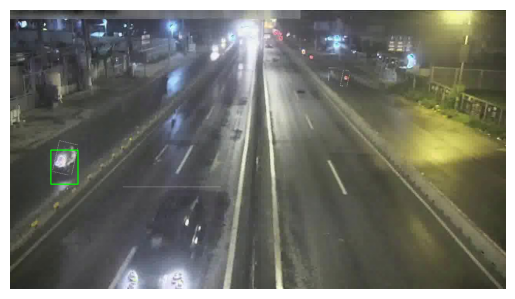


0: 384x640 1 motorbike, 112.2ms
Speed: 2.8ms preprocess, 112.2ms inference, 15.8ms postprocess per image at shape (1, 3, 384, 640)


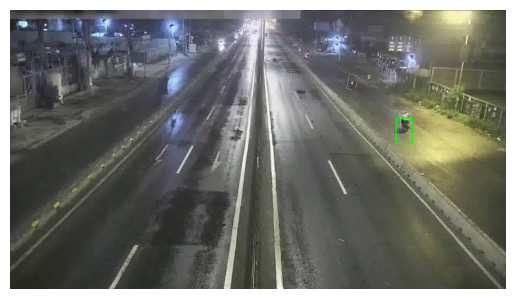


0: 384x640 3 motorbikes, 138.1ms
Speed: 2.8ms preprocess, 138.1ms inference, 12.7ms postprocess per image at shape (1, 3, 384, 640)


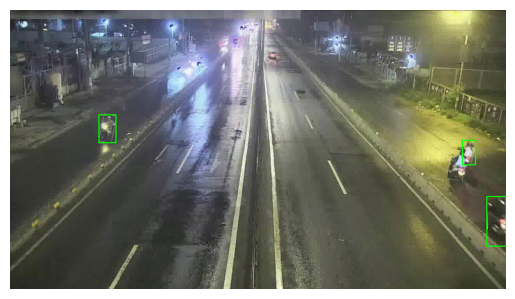


0: 384x640 (no detections), 127.4ms
Speed: 2.1ms preprocess, 127.4ms inference, 1.4ms postprocess per image at shape (1, 3, 384, 640)


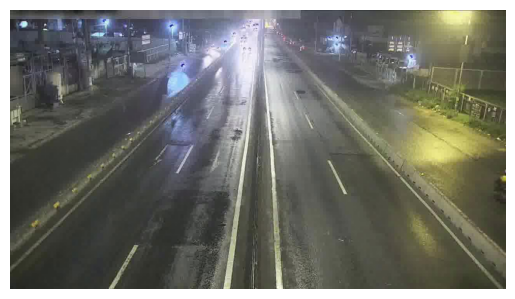


0: 384x640 2 motorbikes, 1 car, 3 trucks, 127.5ms
Speed: 3.5ms preprocess, 127.5ms inference, 25.5ms postprocess per image at shape (1, 3, 384, 640)


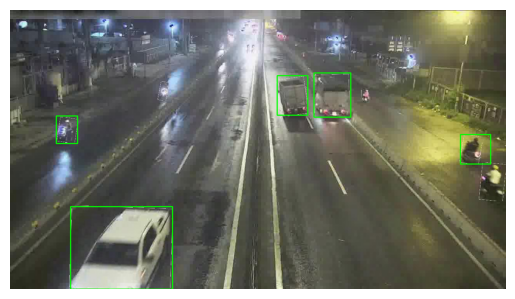


0: 384x640 4 motorbikes, 112.7ms
Speed: 1.8ms preprocess, 112.7ms inference, 12.9ms postprocess per image at shape (1, 3, 384, 640)


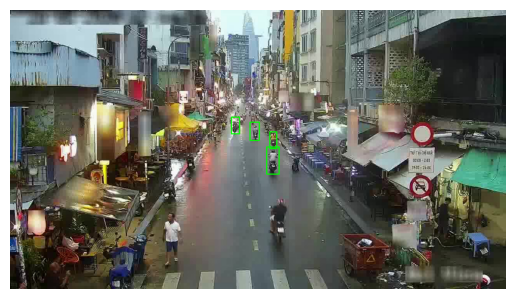


0: 384x640 1 motorbike, 74.0ms
Speed: 1.9ms preprocess, 74.0ms inference, 13.3ms postprocess per image at shape (1, 3, 384, 640)


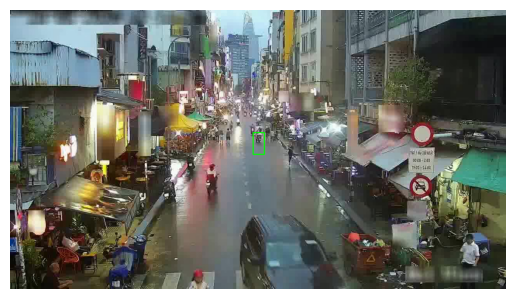


0: 384x640 1 motorbike, 107.3ms
Speed: 1.7ms preprocess, 107.3ms inference, 5.3ms postprocess per image at shape (1, 3, 384, 640)


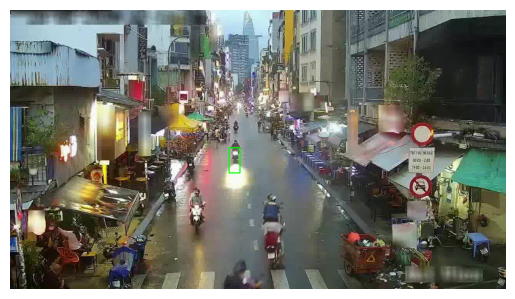


0: 384x640 3 motorbikes, 131.3ms
Speed: 3.9ms preprocess, 131.3ms inference, 8.6ms postprocess per image at shape (1, 3, 384, 640)


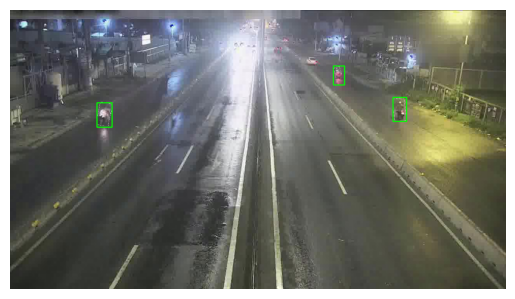


0: 384x640 2 motorbikes, 129.1ms
Speed: 1.9ms preprocess, 129.1ms inference, 13.3ms postprocess per image at shape (1, 3, 384, 640)


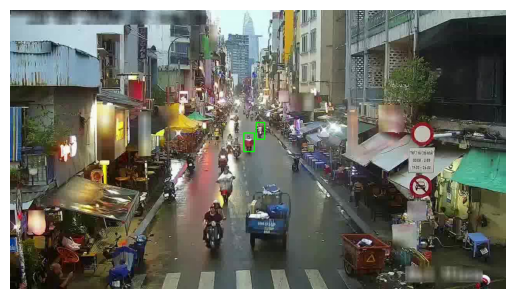


0: 384x640 1 motorbike, 65.7ms
Speed: 1.8ms preprocess, 65.7ms inference, 12.9ms postprocess per image at shape (1, 3, 384, 640)


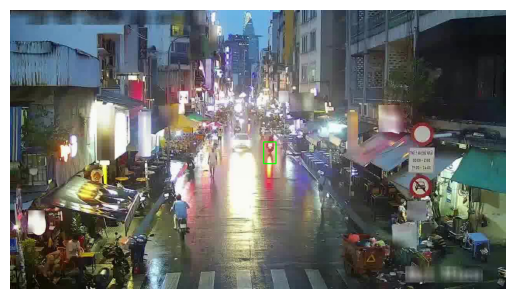


0: 384x640 1 bus, 1 truck, 176.7ms
Speed: 3.5ms preprocess, 176.7ms inference, 15.5ms postprocess per image at shape (1, 3, 384, 640)


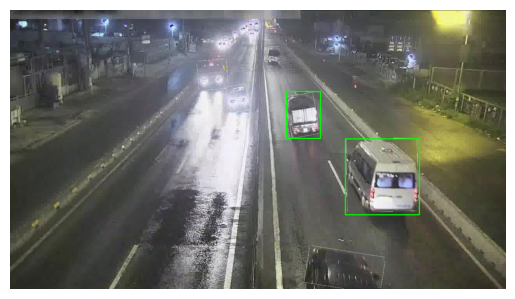


0: 384x640 3 motorbikes, 1 car, 58.0ms
Speed: 2.0ms preprocess, 58.0ms inference, 9.8ms postprocess per image at shape (1, 3, 384, 640)


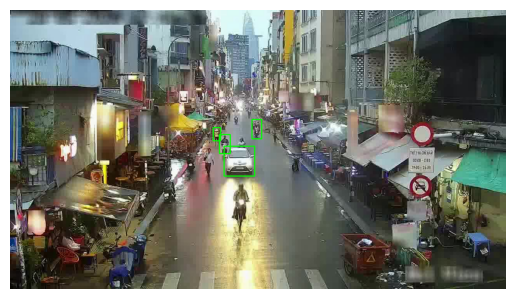


0: 384x640 2 motorbikes, 1 truck, 156.4ms
Speed: 3.6ms preprocess, 156.4ms inference, 13.5ms postprocess per image at shape (1, 3, 384, 640)


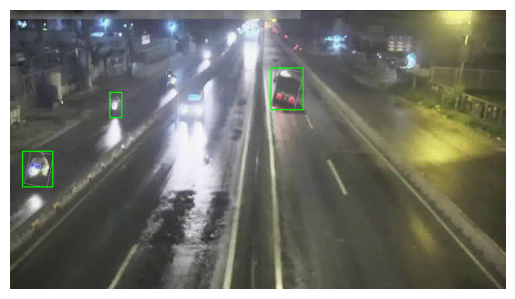


0: 384x640 1 car, 79.1ms
Speed: 2.7ms preprocess, 79.1ms inference, 11.4ms postprocess per image at shape (1, 3, 384, 640)


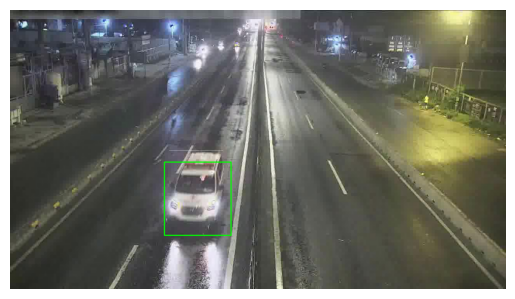


0: 384x640 2 motorbikes, 112.8ms
Speed: 2.4ms preprocess, 112.8ms inference, 9.7ms postprocess per image at shape (1, 3, 384, 640)


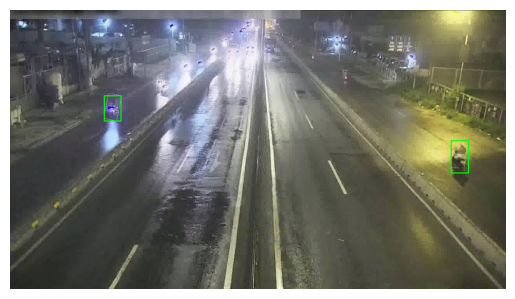


0: 384x640 1 motorbike, 1 truck, 147.6ms
Speed: 1.9ms preprocess, 147.6ms inference, 10.4ms postprocess per image at shape (1, 3, 384, 640)


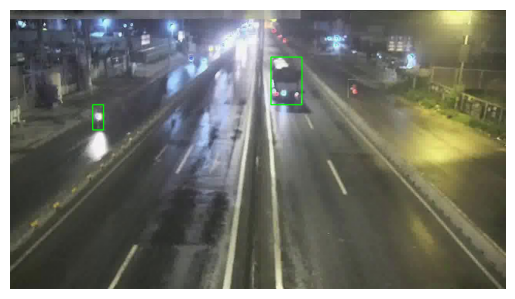


0: 384x640 1 motorbike, 138.9ms
Speed: 3.9ms preprocess, 138.9ms inference, 12.9ms postprocess per image at shape (1, 3, 384, 640)


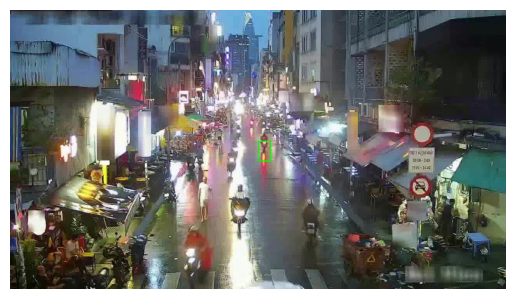


0: 384x640 2 motorbikes, 177.1ms
Speed: 2.3ms preprocess, 177.1ms inference, 12.7ms postprocess per image at shape (1, 3, 384, 640)


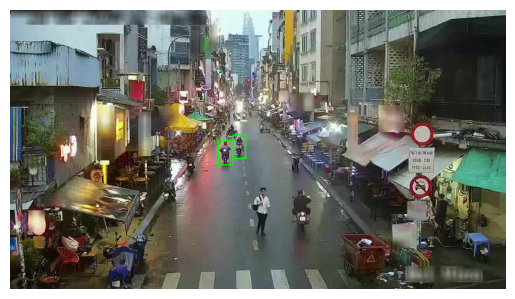


0: 384x640 (no detections), 113.5ms
Speed: 1.6ms preprocess, 113.5ms inference, 1.7ms postprocess per image at shape (1, 3, 384, 640)


KeyboardInterrupt: 

In [24]:
from ultralytics import YOLO
import cv2
import glob
import os
import matplotlib.pyplot as plt

# Đường dẫn dữ liệu và mô hình
folder_path = "../data/raw/private test"
model_path = '../models/base2/base_m/base_m.pt'

# Ngưỡng diện tích bounding box (ví dụ: 30% tổng diện tích ảnh)
MAX_AREA_THRESHOLD_RATIO = 0.3

# Danh sách các hình ảnh
list_img = glob.glob(os.path.join(folder_path, "*.jpg"))

# Tải mô hình YOLO
model = YOLO(model_path)

for img_path in list_img:
    # Đọc ảnh
    image = cv2.imread(img_path)
    if image is None:
        print(f"Unable to read image: {img_path}")
        continue

    # Chạy inference
    results = model(image, conf=conf, device=device)

    # Lọc bounding boxes có diện tích lớn
    image_height, image_width, _ = image.shape
    max_area_threshold = MAX_AREA_THRESHOLD_RATIO * image_width * image_height
    filtered_boxes = []

    for box in results[0].boxes.xyxy:  # xyxy format: [x_min, y_min, x_max, y_max]
        x_min, y_min, x_max, y_max = box[:4]
        area = (x_max - x_min) * (y_max - y_min)
        if area <= max_area_threshold:
            filtered_boxes.append(box)

    # Hiển thị kết quả với các bounding boxes đã lọc
    annotated_image = image.copy()
    for box in filtered_boxes:
        x_min, y_min, x_max, y_max = map(int, box[:4])
        cv2.rectangle(annotated_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

    # Chuyển đổi màu sắc để hiển thị bằng matplotlib
    annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)

    # Hiển thị ảnh đã annotate
    plt.imshow(annotated_image)
    plt.axis('off')  # Ẩn trục
    plt.show()

In [ ]:
import cv2
import numpy as np
import glob
import os
from ultralytics import YOLO
import matplotlib.pyplot as plt


class DayNightClassifier:
    def __init__(self,
                 night_intensity_ratio_threshold: float = 0.55,
                 brightness_threshold: int = 95):
        self.brightness_threshold = brightness_threshold
        self.night_intensity_ratio_threshold = night_intensity_ratio_threshold

    @staticmethod
    def enhance_contrast(image):
        clahe = cv2.createCLAHE(clipLimit=2.15, tileGridSize=(8, 8))
        enhanced_image = clahe.apply(image)
        return enhanced_image

    def calculate_histogram_and_brightness(self, image_path):
        # Đọc hình ảnh và chuyển sang grayscale
        image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
        if image is None:
            return None, None

        # Tăng cường độ tương phản
        image = self.enhance_contrast(image)

        # Tính toán histogram
        hist = cv2.calcHist([image], [0], None, [256], [0, 256])
        hist = hist / hist.sum()

        # Tính độ sáng trung bình
        avg_brightness = np.mean(image)

        # Tính tỷ lệ pixel tối
        dark_pixel_ratio = hist[:self.brightness_threshold].sum()

        return dark_pixel_ratio, avg_brightness

    def isDay(self, image_path):
        dark_pixel_ratio, avg_brightness = self.calculate_histogram_and_brightness(image_path)

        if dark_pixel_ratio is None or avg_brightness is None:
            return None

        # Phân loại dựa trên tỷ lệ pixel tối
        if dark_pixel_ratio > self.night_intensity_ratio_threshold:
            return False  # Đêm

        # Phân loại dựa trên độ sáng trung bình
        return avg_brightness > self.brightness_threshold  # Ngày nếu độ sáng cao hơn ngưỡng


# Cấu hình đường dẫn
folder_path = "../data/raw/private test"
model_day_path = '../models/base2/day/day.pt'
model_night_path = '../models/base2/night/night.pt'

# Tạo đối tượng DayNightClassifier
classifier = DayNightClassifier(night_intensity_ratio_threshold=0.54, brightness_threshold=93)

# Danh sách các hình ảnh
list_img = glob.glob(os.path.join(folder_path, "*.jpg"))

# Lặp qua từng ảnh và thực hiện inference
for img_path in list_img:
    # Kiểm tra ban đêm hay ban ngày
    is_day = classifier.isDay(img_path)
    if is_day is None:
        print(f"Unable to classify image: {img_path}")
        continue

    print(f"Image: {img_path}, Day: {is_day}")
    model_path = model_day_path if is_day else model_night_path

    # Load YOLO model
    model = YOLO(model_path)

    # Đọc ảnh
    image = cv2.imread(img_path)
    if image is None:
        print(f"Unable to read image: {img_path}")
        continue

    # Chạy inference
    results = model(image)

    # Lọc bounding boxes có diện tích lớn
    image_height, image_width, _ = image.shape
    max_area_threshold = 1/6 * image_width * image_height
    filtered_boxes = []

    for box in results[0].boxes.xyxy:  # xyxy format: [x_min, y_min, x_max, y_max]
        x_min, y_min, x_max, y_max = box[:4]
        area = (x_max - x_min) * (y_max - y_min)
        if area <= max_area_threshold:
            filtered_boxes.append(box)

    # Plot filtered results
    annotated_image = image.copy()
    for box in filtered_boxes:
        x_min, y_min, x_max, y_max = map(int, box[:4])
        cv2.rectangle(annotated_image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)

    # Hiển thị ảnh đã annotate
    annotated_image = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    plt.imshow(annotated_image)
    plt.axis('off')  # Hide axis
    plt.show()

# Draw Bbox on Image

In [ ]:
# visualize boundingbox on image
import cv2
import matplotlib.pyplot as plt
import glob
import os

# folder_path = "../data/raw/train_20241023/daytime"
image_path = 'output/'
label_path = 'output/'

list_img = sorted(glob.glob(os.path.join(image_path, "cam_06*.jpg")))
list_label = sorted(glob.glob(os.path.join(label_path, "cam_06*.txt")))

for img_path, label_path in zip(list_img, list_label):
    # Load image
    image = cv2.imread(img_path)
    height, width, _ = image.shape
    
    # Load label
    with open(label_path, 'r') as f:
        lines = f.readlines()
    labels = [line.strip().split() for line in lines]
    
    # Convert YOLO format to bounding box coordinates
    for label in labels:
        class_id, x_center, y_center, bbox_width, bbox_height = map(float, label)
        x_center *= width
        y_center *= height
        bbox_width *= width
        bbox_height *= height
        
        x_min = int(x_center - bbox_width / 2)
        y_min = int(y_center - bbox_height / 2)
        x_max = int(x_center + bbox_width / 2)
        y_max = int(y_center + bbox_height / 2)
        
        # Draw bounding boxes
        cv2.rectangle(image, (x_min, y_min), (x_max, y_max), (0, 255, 0), 2)
    
    # Show image
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    plt.imshow(image)
    plt.axis('off')  # Hide axis
    plt.show()